<a href="https://colab.research.google.com/github/head1ton/004_Supervision/blob/main/detect_and_count_objects_in_polygon_zone.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


In [2]:
import torch
!nvcc --version

TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2024 NVIDIA Corporation
Built on Thu_Jun__6_02:18:23_PDT_2024
Cuda compilation tools, release 12.5, V12.5.82
Build cuda_12.5.r12.5/compiler.34385749_0


In [3]:
torch.__version__

'2.6.0+cu124'

In [4]:
TORCH_VERSION

'2.6'

In [5]:
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)

torch:  2.6 ; cuda:  cu124


In [6]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [7]:
# install YOLOv5
%cd {HOME}
!git clone https://github.com/ultralytics/YOLOv5

%cd {HOME}/YOLOv5
!pip install -r requirements.txt

from IPython import display
display.clear_output()

In [9]:
# install YOLOv8
!pip install "ultralytics<=8.3.40"

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics 8.3.40 🚀 Python-3.11.11 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 41.2/107.7 GB disk)


In [10]:
# install Detectron2

!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

from IPython import display
display.clear_output()

import detectron2
print("detectron2:", detectron2.__version__)

detectron2: 0.6


In [11]:
# install supervision

!pip install supervision

from IPython import display
display.clear_output()

import supervision as sv
print("supervision", sv.__version__)

supervision 0.25.1


In [12]:
# Download data

!pip install supervision[assets] -q

from IPython import display
display.clear_output()

In [14]:
from supervision.assets import download_assets, VideoAssets
from IPython import display

download_assets(VideoAssets.MARKET_SQUARE)
download_assets(VideoAssets.GROCERY_STORE)
download_assets(VideoAssets.SUBWAY)

display.clear_output()

In [15]:
# Simple YOLOv8 Shopping Mall Example

from ultralytics import YOLO

model = YOLO('yolov8s.pt')

100%|██████████| 21.5M/21.5M [00:00<00:00, 130MB/s] 


In [16]:
import supervision as sv

generator = sv.get_video_frames_generator(VideoAssets.GROCERY_STORE.value)
iterator = iter(generator)
frame = next(iterator)

In [18]:
frame[0]

array([[133, 143, 147],
       [133, 143, 147],
       [133, 143, 147],
       ...,
       [ 18, 198, 251],
       [ 21, 196, 250],
       [ 21, 196, 250]], dtype=uint8)

In [19]:
len(frame)

2160

In [20]:
# detect
results = model(frame, imgsz=1280)
results


0: 736x1280 1 person, 4 bottles, 1 chair, 1 tv, 2 refrigerators, 2055.1ms
Speed: 70.6ms preprocess, 2055.1ms inference, 43.1ms postprocess per image at shape (1, 3, 736, 1280)


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted p

In [22]:
len(results)

1

In [21]:
results[0]

ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant',

In [23]:
results = model(frame, imgsz=1280)[0]
detections = sv.Detections.from_ultralytics(results)


0: 736x1280 1 person, 4 bottles, 1 chair, 1 tv, 2 refrigerators, 1896.6ms
Speed: 23.7ms preprocess, 1896.6ms inference, 3.0ms postprocess per image at shape (1, 3, 736, 1280)


In [24]:
detections[0]

Detections(xyxy=array([[       2254,       905.9,      2447.4,        1353]], dtype=float32), mask=None, confidence=array([    0.90538], dtype=float32), class_id=array([0]), tracker_id=None, data={'class_name': array(['person'], dtype='<U12')}, metadata={})

In [25]:
detections[:5]

Detections(xyxy=array([[       2254,       905.9,      2447.4,        1353],
       [     2048.7,      1132.8,      2226.4,        1371],
       [     726.99,      1223.5,      837.62,      1600.6],
       [     808.22,      1214.5,      910.29,      1563.7],
       [     6.0249,      51.737,      1131.2,      2133.1]], dtype=float32), mask=None, confidence=array([    0.90538,     0.59002,     0.51119,     0.45287,     0.45057], dtype=float32), class_id=array([ 0, 56, 39, 39, 72]), tracker_id=None, data={'class_name': array(['person', 'chair', 'bottle', 'bottle', 'refrigerator'], dtype='<U12')}, metadata={})

In [28]:
# annotate
box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections)

frame[:3]

array([[[133, 143, 147],
        [133, 143, 147],
        [133, 143, 147],
        ...,
        [ 18, 198, 251],
        [ 21, 196, 250],
        [ 21, 196, 250]],

       [[133, 143, 147],
        [133, 143, 147],
        [133, 143, 147],
        ...,
        [ 18, 198, 251],
        [ 21, 196, 250],
        [ 21, 196, 250]],

       [[133, 143, 147],
        [133, 143, 147],
        [133, 143, 147],
        ...,
        [ 14, 198, 251],
        [ 17, 197, 250],
        [ 17, 197, 250]]], dtype=uint8)

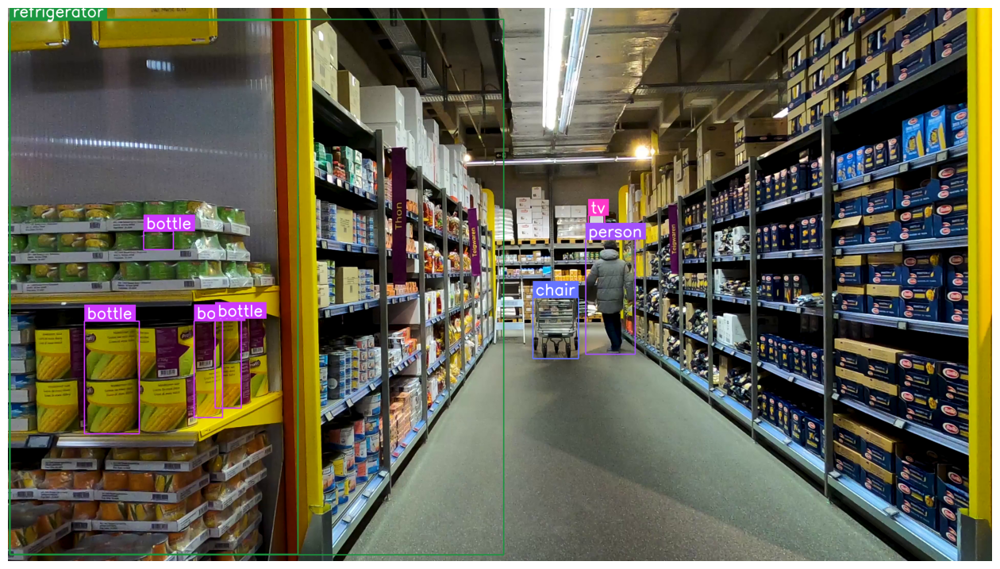

In [29]:
%matplotlib inline
sv.plot_image(frame, (16, 16))

In [30]:
detections[:3]

Detections(xyxy=array([[       2254,       905.9,      2447.4,        1353],
       [     2048.7,      1132.8,      2226.4,        1371],
       [     726.99,      1223.5,      837.62,      1600.6]], dtype=float32), mask=None, confidence=array([    0.90538,     0.59002,     0.51119], dtype=float32), class_id=array([ 0, 56, 39]), tracker_id=None, data={'class_name': array(['person', 'chair', 'bottle'], dtype='<U12')}, metadata={})

In [35]:
detections.__dict__.keys()

dict_keys(['xyxy', 'mask', 'confidence', 'class_id', 'tracker_id', 'data', 'metadata'])


0: 736x1280 1 person, 4 bottles, 1 chair, 1 tv, 2 refrigerators, 1481.2ms
Speed: 14.1ms preprocess, 1481.2ms inference, 2.8ms postprocess per image at shape (1, 3, 736, 1280)


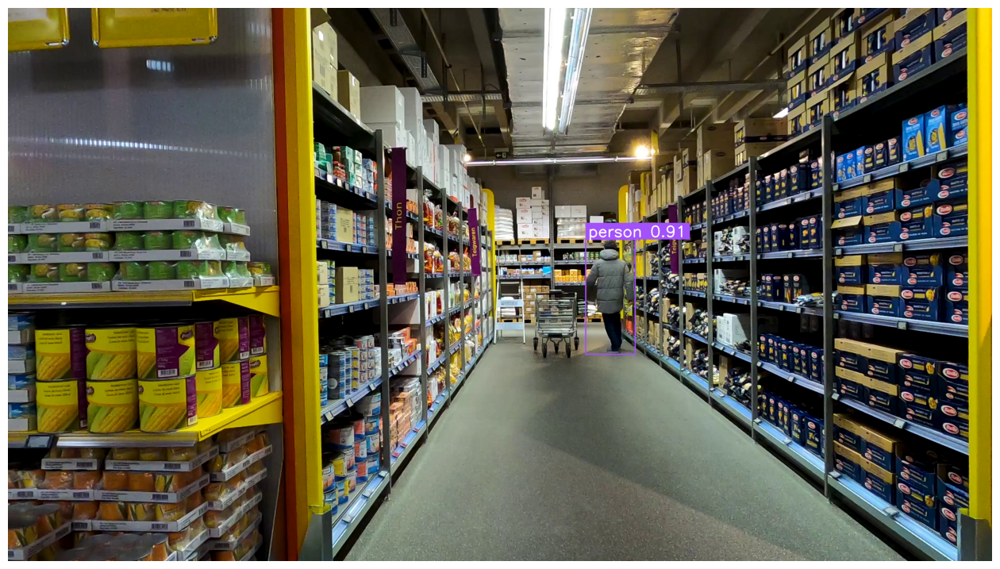

In [38]:
from ast import increment_lineno
import supervision as sv

# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.GROCERY_STORE.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame, imgsz=1280)[0]
detections = sv.Detections.from_ultralytics(results)
detections = detections[detections.class_id == 0] # person

# annotate
box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
labels = [f"{model.names[class_id]} {confidence:0.2f}" for _, _, confidence, class_id, _, _ in detections]
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections, labels=labels)

%matplotlib inline
sv.plot_image(frame, (16, 16))

In [40]:
sv.VideoInfo.__dict__

mappingproxy({'__module__': 'supervision.utils.video',
              '__annotations__': {'width': 'int',
               'height': 'int',
               'fps': 'int',
               'total_frames': 'Optional[int]'},
              '__doc__': '\n    A class to store video information, including width, height, fps and\n        total number of frames.\n\n    Attributes:\n        width (int): width of the video in pixels\n        height (int): height of the video in pixels\n        fps (int): frames per second of the video\n        total_frames (Optional[int]): total number of frames in the video,\n            default is None\n\n    Examples:\n        ```python\n        import supervision as sv\n\n        video_info = sv.VideoInfo.from_video_path(video_path=<SOURCE_VIDEO_FILE>)\n\n        video_info\n        # VideoInfo(width=3840, height=2160, fps=25, total_frames=538)\n\n        video_info.resolution_wh\n        # (3840, 2160)\n        ```\n    ',
              'total_frames': None,
      

In [41]:
sv.VideoInfo.from_video_path(VideoAssets.GROCERY_STORE.value)

VideoInfo(width=3840, height=2160, fps=29, total_frames=1002)


0: 736x1280 1 person, 4 bottles, 1 chair, 1 tv, 2 refrigerators, 2382.1ms
Speed: 25.0ms preprocess, 2382.1ms inference, 6.4ms postprocess per image at shape (1, 3, 736, 1280)


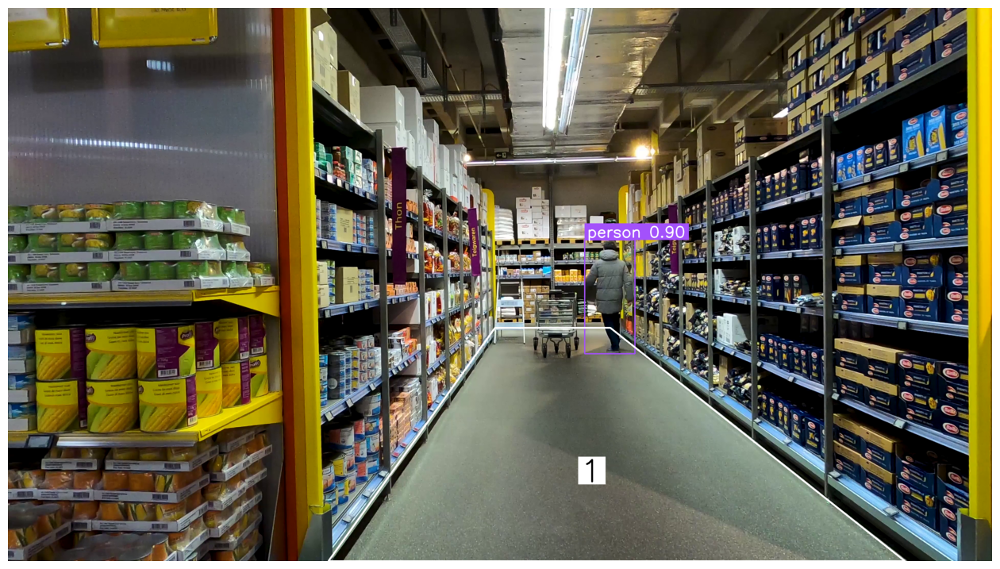

In [44]:
import numpy as np
import supervision as sv

# initiate polygon zone
polygon = np.array([
    [1900, 1250],
    [2350, 1250],
    [3500, 2160],
    [1250, 2160]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.GROCERY_STORE.value)
zone = sv.PolygonZone(polygon=polygon)

# initiate annoators
box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.WHITE, thickness=6, text_thickness=6, text_scale=4)

# extract video frame
geneator = sv.get_video_frames_generator(VideoAssets.GROCERY_STORE.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame, imgsz=1280)[0]
detections = sv.Detections.from_ultralytics(results)
detections = detections[detections.class_id == 0]
zone.trigger(detections=detections)

# annotate
labels = [f"{model.names[class_id]} {confidence:0.2f}" for _, _, confidence, class_id, _, _ in detections]
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections, labels=labels)
frame = zone_annotator.annotate(scene=frame)

sv.plot_image(frame, (16, 16))


0: 736x1280 1 person, 3 bottles, 1 chair, 2 tvs, 2 refrigerators, 2214.5ms
Speed: 47.1ms preprocess, 2214.5ms inference, 3.3ms postprocess per image at shape (1, 3, 736, 1280)


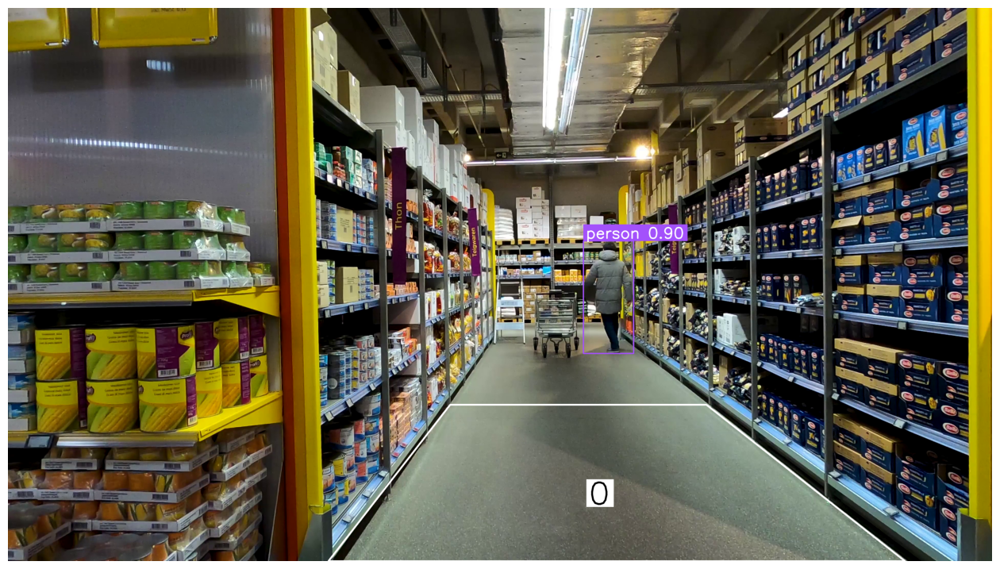

In [45]:
import numpy as np
import supervision as sv

# initiate polygon zone
polygon = np.array([
    [1725, 1550],
    [2725, 1550],
    [3500, 2160],
    [1250, 2160]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.GROCERY_STORE.value)
zone = sv.PolygonZone(polygon=polygon)

# initiate annoators
box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.WHITE, thickness=6, text_thickness=6, text_scale=4)

# extract video frame
geneator = sv.get_video_frames_generator(VideoAssets.GROCERY_STORE.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame, imgsz=1280)[0]
detections = sv.Detections.from_ultralytics(results)
detections = detections[detections.class_id == 0]
zone.trigger(detections=detections)

# annotate
labels = [f"{model.names[class_id]} {confidence:0.2f}" for _, _, confidence, class_id, _, _ in detections]
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections, labels=labels)
frame = zone_annotator.annotate(scene=frame)

sv.plot_image(frame, (16, 16))

In [47]:
import numpy as np
import supervision as sv

# initiate polygon zone
polygon = np.array([
    [1725, 1550],
    [2725, 1550],
    [3500, 2160],
    [1250, 2160]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.GROCERY_STORE.value)
zone = sv.PolygonZone(polygon=polygon)

# initiate annoators
box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.WHITE, thickness=6, text_thickness=6, text_scale=4)

def process_frame(frame: np.ndarray, _) -> np.ndarray:
    # detect
    results = model(frame, imgsz=1280)[0]
    detections = sv.Detections.from_ultralytics(results)
    detections = detections[detections.class_id == 0]
    zone.trigger(detections=detections)

    # annotate
    labels = [f"{model.names[class_id]} {confidence:0.2f}" for _, _, confidence, class_id, _, _ in detections]
    frame = box_annotator.annotate(scene=frame, detections=detections)
    frame = label_annotator.annotate(scene=frame, detections=detections, labels=labels)
    frame = zone_annotator.annotate(scene=frame)

    return frame

sv.process_video(source_path=VideoAssets.GROCERY_STORE.value, target_path=f"{HOME}/mall-result.mp4", callback=process_frame)

from IPython import display
display.clear_output()

In [49]:
# Simple Detectron2 Subway Example

from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
# cfg.MODEL.DEVICE = "cpu"  # Explicitly set device to CPU
predictor = DefaultPredictor(cfg)

model_final_f10217.pkl: 178MB [00:01, 98.2MB/s]                          


In [57]:
outputs

{'instances': Instances(num_instances=23, image_height=3840, image_width=2160, fields=[pred_boxes: Boxes(tensor([[1324.5367, 1032.5068, 1495.8273, 1478.8419],
         [1200.1953, 1331.4215, 1453.9526, 1963.7922],
         [1207.0051,  869.2179, 1333.5608, 1294.6017],
         [1298.3861, 2227.2542, 1730.7426, 3007.6145],
         [1544.8351,  994.4420, 1755.5231, 1629.7087],
         [1046.6758, 2907.1621, 1781.9962, 3821.3955],
         [2026.6459, 1205.2726, 2156.2175, 1813.6915],
         [1465.5260,  760.9618, 1583.5144, 1091.8267],
         [1305.1713, 1635.0352, 1456.1750, 1874.7556],
         [1215.9951,  940.1754, 1313.3220, 1092.6919],
         [1288.7091, 2765.5552, 1400.0732, 2992.8650],
         [1566.9694,  753.6495, 1664.0833,  999.2357],
         [ 852.4357, 2926.0996, 1148.6426, 3187.5559],
         [1426.3004,  603.9127, 1501.8928,  847.3453],
         [1297.6743,  506.8392, 1353.2946,  651.2302],
         [1346.3459,  673.6746, 1419.0210,  897.4553],
         [1398.7

In [58]:
outputs["instances"]

Instances(num_instances=23, image_height=3840, image_width=2160, fields=[pred_boxes: Boxes(tensor([[1324.5367, 1032.5068, 1495.8273, 1478.8419],
        [1200.1953, 1331.4215, 1453.9526, 1963.7922],
        [1207.0051,  869.2179, 1333.5608, 1294.6017],
        [1298.3861, 2227.2542, 1730.7426, 3007.6145],
        [1544.8351,  994.4420, 1755.5231, 1629.7087],
        [1046.6758, 2907.1621, 1781.9962, 3821.3955],
        [2026.6459, 1205.2726, 2156.2175, 1813.6915],
        [1465.5260,  760.9618, 1583.5144, 1091.8267],
        [1305.1713, 1635.0352, 1456.1750, 1874.7556],
        [1215.9951,  940.1754, 1313.3220, 1092.6919],
        [1288.7091, 2765.5552, 1400.0732, 2992.8650],
        [1566.9694,  753.6495, 1664.0833,  999.2357],
        [ 852.4357, 2926.0996, 1148.6426, 3187.5559],
        [1426.3004,  603.9127, 1501.8928,  847.3453],
        [1297.6743,  506.8392, 1353.2946,  651.2302],
        [1346.3459,  673.6746, 1419.0210,  897.4553],
        [1398.7017,  595.0386, 1446.1423,  82

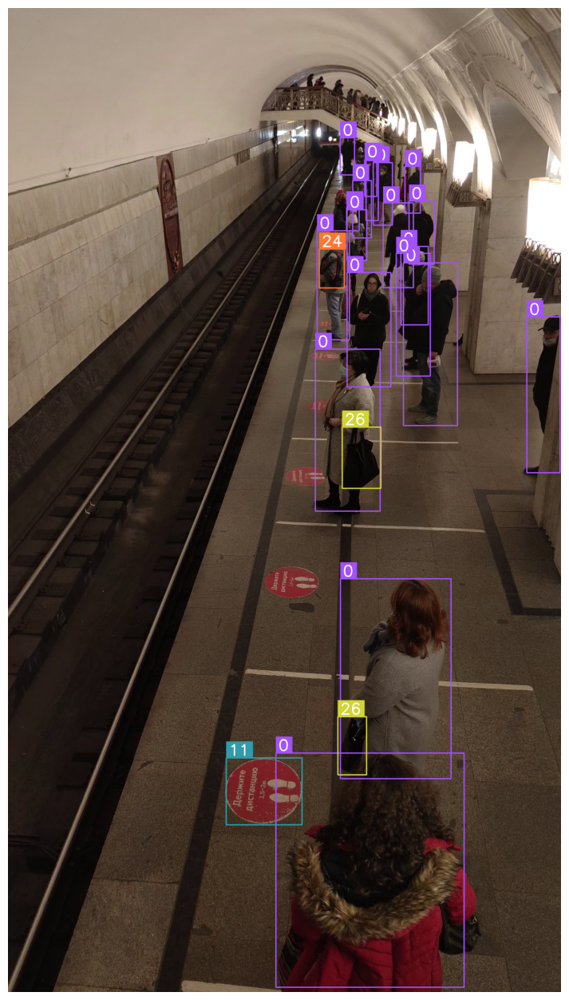

In [50]:
# YOLOv8 inference pipeline

import supervision as sv

# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.SUBWAY.value)
iterator = iter(generator)
frame = next(iterator)

# detect
outputs = predictor(frame)
detections = sv.Detections(
    xyxy=outputs["instances"].pred_boxes.tensor.cpu().numpy(),
    confidence=outputs["instances"].scores.cpu().numpy(),
    class_id=outputs["instances"].pred_classes.cpu().numpy().astype(int)
)

# annotate
box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections)

sv.plot_image(frame, (16, 16))

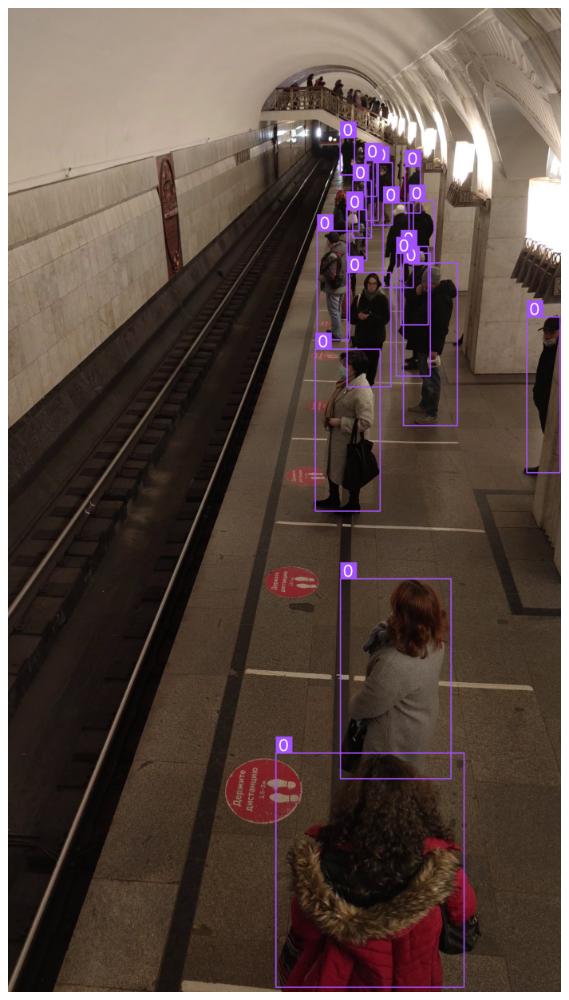

In [59]:
import supervision as sv

# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.SUBWAY.value)
iterator = iter(generator)
frame = next(iterator)

# detect
outputs = predictor(frame)
detections = sv.Detections(
    xyxy=outputs["instances"].pred_boxes.tensor.cpu().numpy(),
    confidence=outputs["instances"].scores.cpu().numpy(),
    class_id=outputs["instances"].pred_classes.cpu().numpy().astype(int)
)
detections = detections[detections.class_id == 0]

# annotate
box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections)

sv.plot_image(frame, (16, 16))

In [60]:
sv.VideoInfo.from_video_path(VideoAssets.SUBWAY.value)

VideoInfo(width=2160, height=3840, fps=29, total_frames=1298)

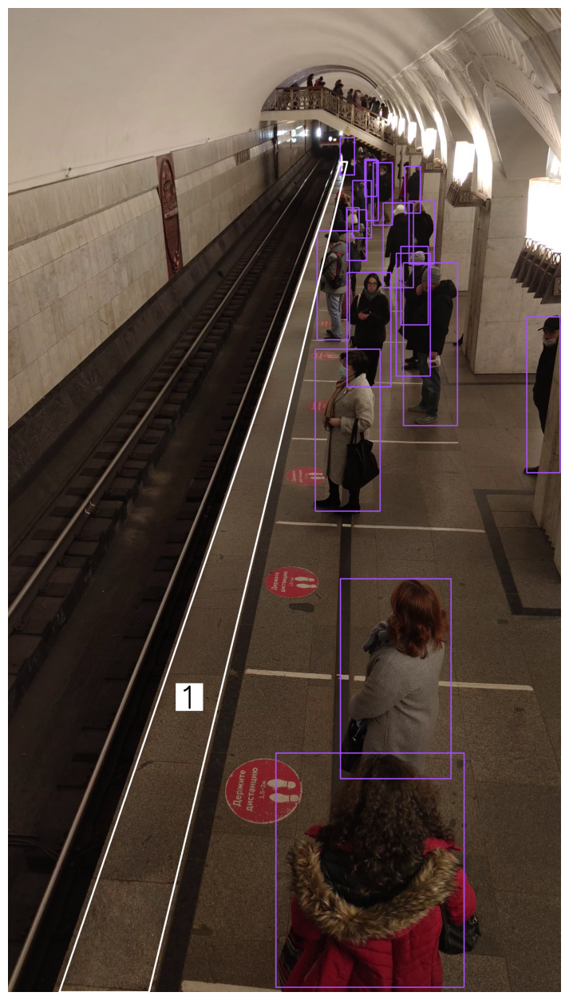

In [63]:
import numpy as np
import supervision as sv

polygon = np.array([
    [200, 3840],
    [1300, 600],
    [1325, 600],
    [550, 3840]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.SUBWAY.value)
zone = sv.PolygonZone(polygon=polygon)

box_annotator = sv.BoxAnnotator(thickness=4)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.WHITE, thickness=6, text_thickness=6, text_scale=4)

generator = sv.get_video_frames_generator(VideoAssets.SUBWAY.value)
iterator = iter(generator)
frame = next(iterator)

outputs = predictor(frame)
detections = sv.Detections(
    xyxy=outputs["instances"].pred_boxes.tensor.cpu().numpy(),
    confidence=outputs["instances"].scores.cpu().numpy(),
    class_id=outputs["instances"].pred_classes.cpu().numpy().astype(int)
)
detections = detections[detections.class_id == 0]
zone.trigger(detections=detections)

frame = box_annotator.annotate(scene=frame, detections=detections)
frame = zone_annotator.annotate(scene=frame)

sv.plot_image(frame, (16, 16))

In [67]:
import numpy as np
import supervision as sv

polygon = np.array([
    [200, 3840],
    [1300, 600],
    [1325, 600],
    [550, 3840]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.SUBWAY.value)
zone = sv.PolygonZone(polygon=polygon)

box_annotator = sv.BoxAnnotator(thickness=4)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.WHITE, thickness=6, text_thickness=6, text_scale=4)

def process_frame(frame:np.ndarray, i: int) -> np.ndarray:
    outputs = predictor(frame)
    detections = sv.Detections(
        xyxy=outputs["instances"].pred_boxes.tensor.cpu().numpy(),
        confidence=outputs["instances"].scores.cpu().numpy(),
        class_id=outputs["instances"].pred_classes.cpu().numpy().astype(int)
    )
    detections = detections[detections.class_id == 0]
    zone.trigger(detections=detections)

    frame = box_annotator.annotate(scene=frame, detections=detections)
    frame = zone_annotator.annotate(scene=frame)

    return frame

sv.process_video(source_path=VideoAssets.SUBWAY.value, target_path=f"{HOME}/subway-result.mp4", callback=process_frame)

from IPython import display
display.clear_output()

In [ ]:
## Advanced YOLOv5 Market Square Example

In [68]:
import torch

model = torch.hub.load('ultralytics/yolov5', 'yolov5x6')

Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2025-3-22 Python-3.11.11 torch-2.6.0+cu124 CPU

100%|██████████| 270M/270M [00:01<00:00, 243MB/s]

Fusing layers... 
YOLOv5x6 summary: 574 layers, 140730220 parameters, 0 gradients, 209.6 GFLOPs
Adding AutoShape... 


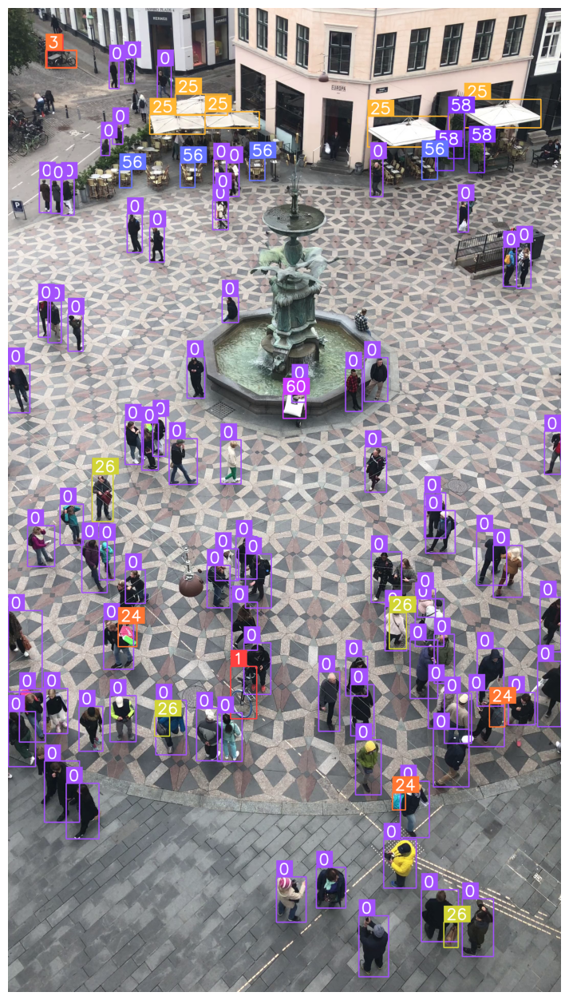

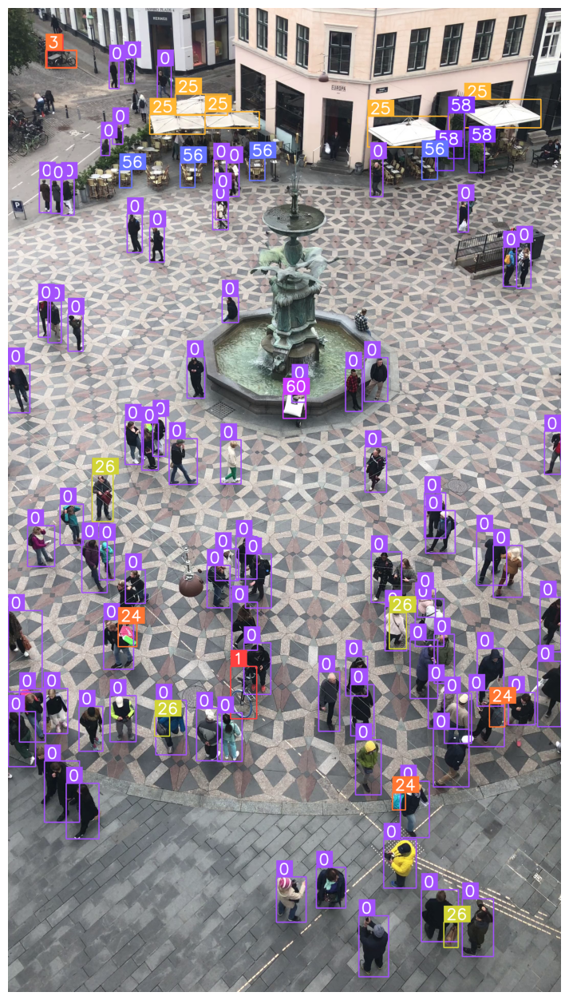

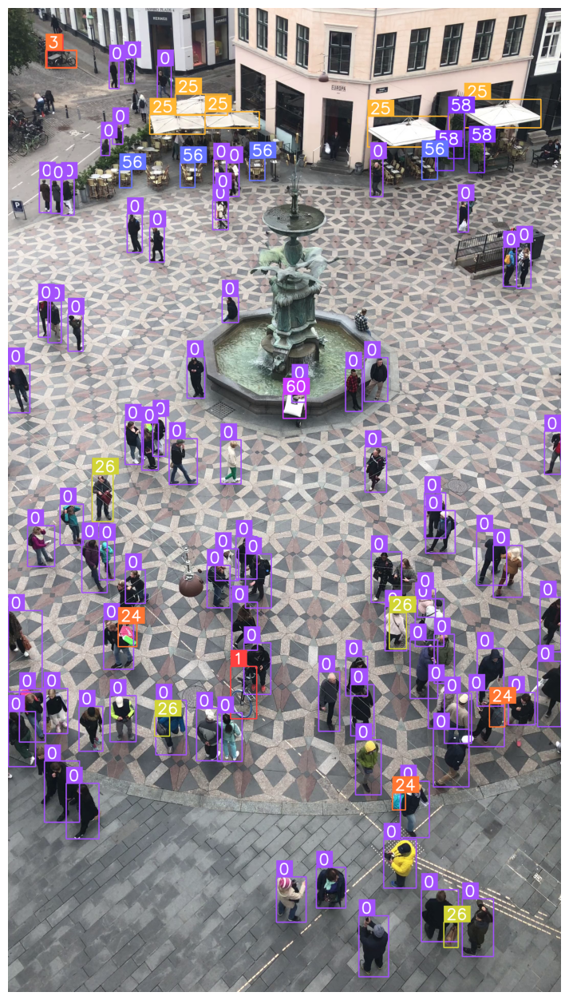

In [71]:
import supervision as sv

generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

results = model(frame, size=1280)
detections = sv.Detections.from_yolov5(results)

box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections)

%matplotlib inline
sv.plot_image(frame, (16, 16))

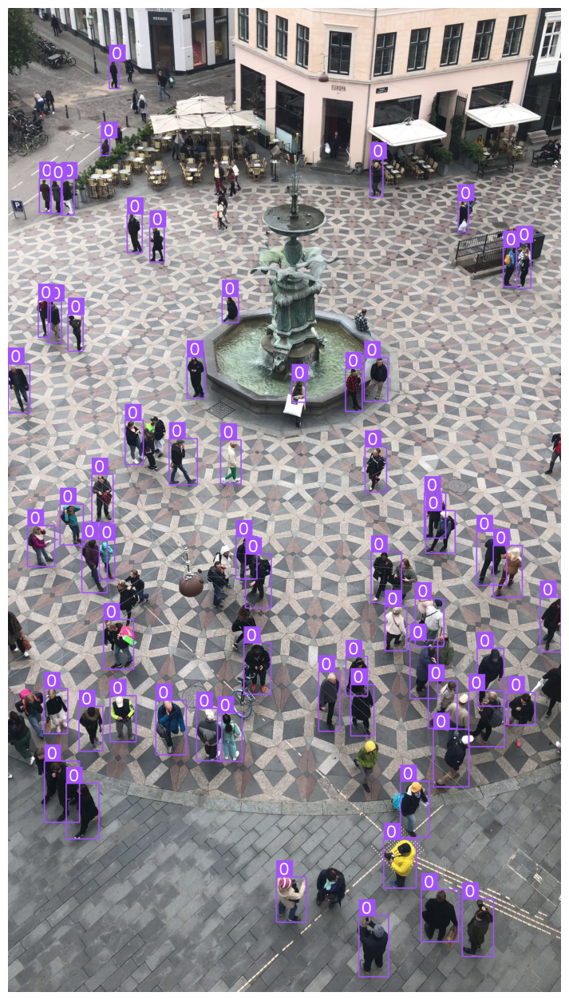

In [73]:
import supervision as sv

generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

results = model(frame, size=1280)
detections = sv.Detections.from_yolov5(results)
detections = detections[(detections.class_id == 0) & (detections.confidence > 0.5)]

box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections)

%matplotlib inline
sv.plot_image(frame, (16, 16))

In [74]:
len(detections)

64

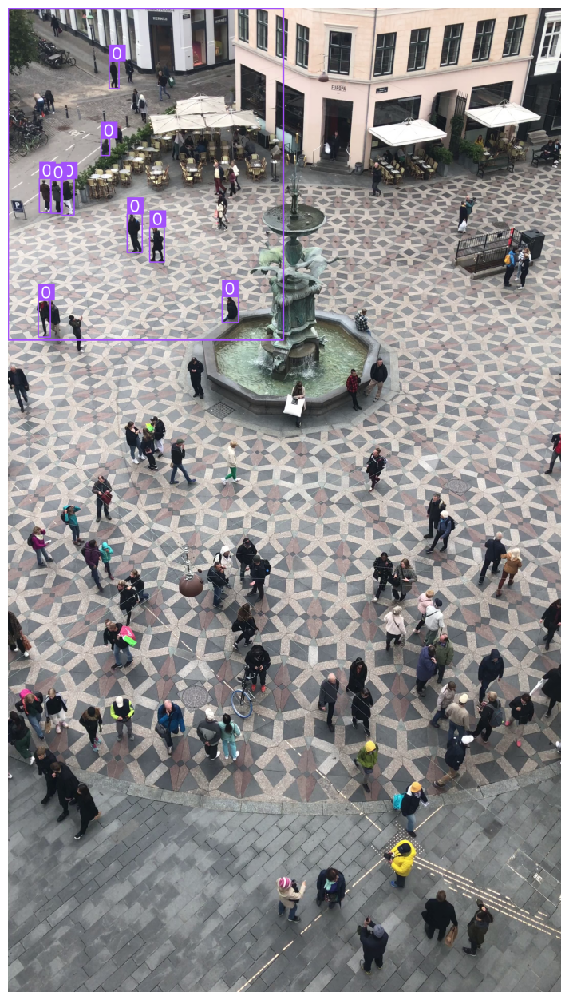

In [77]:
# Square

import supervision as sv

polygon = np.array([
    [0, 0],
    [1080 - 5, 0],
    [1080 - 5, 1300 - 5],
    [0, 1300 - 5]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.MARKET_SQUARE.value)
zone = sv.PolygonZone(polygon=polygon)

generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

results = model(frame, size=1280)
detections = sv.Detections.from_yolov5(results)
mask = zone.trigger(detections=detections)
detections = detections[(detections.class_id == 0) & (detections.confidence > 0.5) & mask]

box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections)
frame = sv.draw_polygon(scene=frame, polygon=polygon, color=sv.Color.ROBOFLOW, thickness=6)

%matplotlib inline
sv.plot_image(frame, (16, 16))

In [78]:
sv.VideoInfo.from_video_path(VideoAssets.MARKET_SQUARE.value)

VideoInfo(width=2160, height=3840, fps=60, total_frames=474)

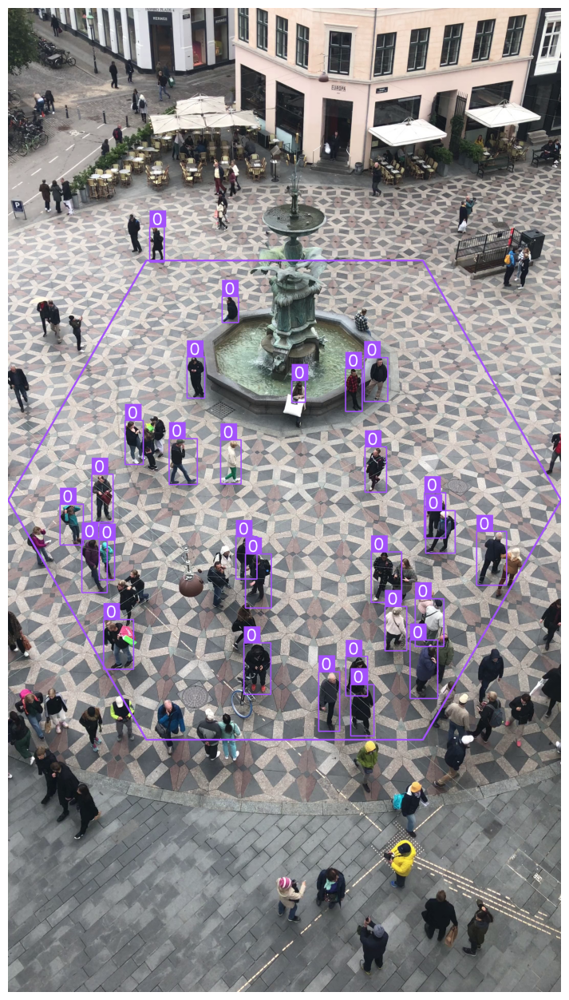

In [79]:
# Square

import supervision as sv

polygon = np.array([
    [540,  985],
    [1620, 985],
    [2160, 1920],
    [1620, 2855],
    [540,  2855],
    [0,    1920]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.MARKET_SQUARE.value)
zone = sv.PolygonZone(polygon=polygon)

generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

results = model(frame, size=1280)
detections = sv.Detections.from_yolov5(results)
mask = zone.trigger(detections=detections)
detections = detections[(detections.class_id == 0) & (detections.confidence > 0.5) & mask]

box_annotator = sv.BoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections)
frame = sv.draw_polygon(scene=frame, polygon=polygon, color=sv.Color.ROBOFLOW, thickness=6)

%matplotlib inline
sv.plot_image(frame, (16, 16))

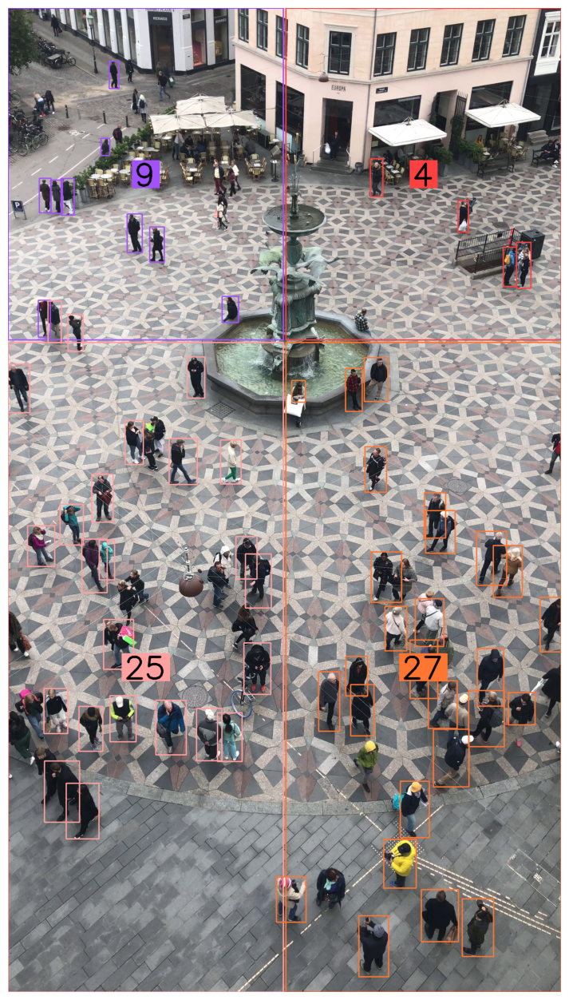

In [80]:
# Square

import supervision as sv

colors = sv.ColorPalette.DEFAULT
polygons = [
    np.array([
        [0, 0],
        [1080 - 5, 0],
        [1080 - 5, 1300 - 5],
        [0, 1300 - 5]
    ], np.int32),
    np.array([
        [1080 + 5, 0],
        [2160, 0],
        [2160, 1300 - 5],
        [1080 + 5, 1300 - 5]
    ], np.int32),
    np.array([
        [0, 1300 + 5],
        [1080 - 5, 1300 + 5],
        [1080 - 5, 3840],
        [0, 3840]
    ], np.int32),
    np.array([
        [1080 + 5, 1300 + 5],
        [2160, 1300 + 5],
        [2160, 3840],
        [1080 + 5, 3840]
    ], np.int32)
]

video_info = sv.VideoInfo.from_video_path(VideoAssets.MARKET_SQUARE.value)
zones = [sv.PolygonZone(polygon=polygon) for polygon in polygons]
zone_annotators = [
    sv.PolygonZoneAnnotator(
        zone=zone,
        color=colors.by_idx(index),
        thickness=4,
        text_thickness=8,
        text_scale=4
    )
    for index, zone
    in enumerate(zones)
]

box_annotators = [
    sv.BoxAnnotator(
        color=colors.by_idx(index),
        thickness=4,
    )
    for index
    in range(len(polygons))
]

generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

results = model(frame, size=1280)
detections = sv.Detections.from_yolov5(results)
detections = detections[(detections.class_id == 0) & (detections.confidence > 0.5)]

for zone, zone_annotator, box_annotator in zip(zones, zone_annotators, box_annotators):
    mask = zone.trigger(detections=detections)
    detections_filtered = detections[mask]
    frame = box_annotator.annotate(scene=frame, detections=detections_filtered)
    frame = zone_annotator.annotate(scene=frame)

%matplotlib inline
sv.plot_image(frame, (16, 16))

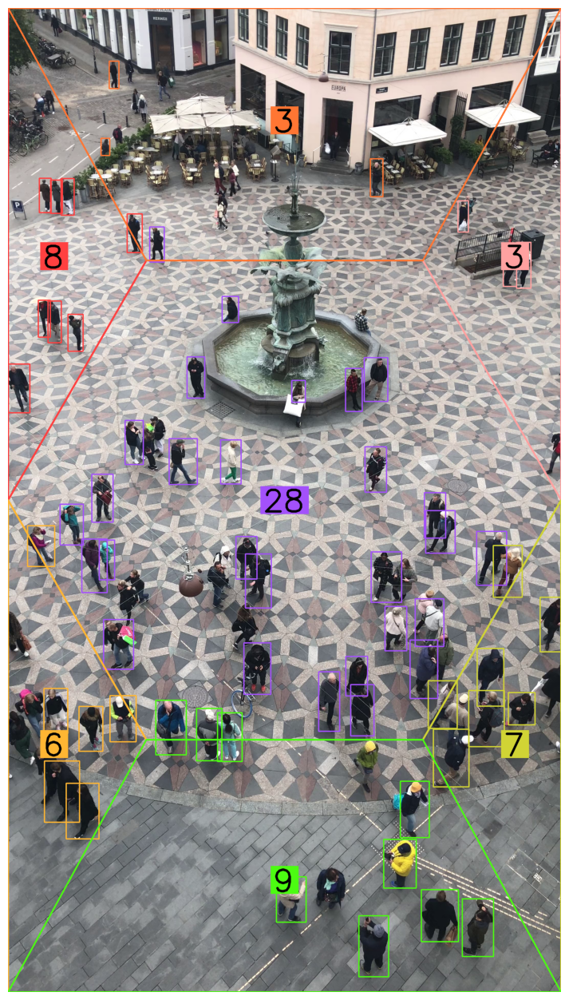

In [81]:
# Square

import supervision as sv

colors = sv.ColorPalette.DEFAULT
polygons = [
    np.array([
        [540,  985 ],
        [1620, 985 ],
        [2160, 1920],
        [1620, 2855],
        [540,  2855],
        [0,    1920]
    ], np.int32),
    np.array([
        [0,    1920],
        [540,  985 ],
        [0,    0   ]
    ], np.int32),
    np.array([
        [1620, 985 ],
        [2160, 1920],
        [2160,    0]
    ], np.int32),
    np.array([
        [540,  985 ],
        [0,    0   ],
        [2160, 0   ],
        [1620, 985 ]
    ], np.int32),
    np.array([
        [0,    1920],
        [0,    3840],
        [540,  2855]
    ], np.int32),
    np.array([
        [2160, 1920],
        [1620, 2855],
        [2160, 3840]
    ], np.int32),
    np.array([
        [1620, 2855],
        [540,  2855],
        [0,    3840],
        [2160, 3840]
    ], np.int32)
]

video_info = sv.VideoInfo.from_video_path(VideoAssets.MARKET_SQUARE.value)

zones = [sv.PolygonZone(polygon=polygon) for polygon in polygons]
zone_annotators = [
    sv.PolygonZoneAnnotator(
        zone=zone,
        color=colors.by_idx(index),
        thickness=6,
        text_thickness=8,
        text_scale=4
    )
    for index, zone
    in enumerate(zones)
]

box_annotators = [
    sv.BoxAnnotator(
        color=colors.by_idx(index),
        thickness=4,
    )
    for index
    in range(len(polygons))
]

generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

results = model(frame, size=1280)
detections = sv.Detections.from_yolov5(results)
detections = detections[(detections.class_id == 0) & (detections.confidence > 0.5)]

for zone, zone_annotator, box_annotator in zip(zones, zone_annotators, box_annotators):
    mask = zone.trigger(detections=detections)
    detections_filtered = detections[mask]
    frame = box_annotator.annotate(scene=frame, detections=detections_filtered)
    frame = zone_annotator.annotate(scene=frame)

%matplotlib inline
sv.plot_image(frame, (16, 16))

In [ ]:
colors = sv.ColorPalette.DEFAULT
polygons = [
    np.array([
        [540,  985 ],
        [1620, 985 ],
        [2160, 1920],
        [1620, 2855],
        [540,  2855],
        [0,    1920]
    ], np.int32),
    np.array([
        [0,    1920],
        [540,  985 ],
        [0,    0   ]
    ], np.int32),
    np.array([
        [1620, 985 ],
        [2160, 1920],
        [2160,    0]
    ], np.int32),
    np.array([
        [540,  985 ],
        [0,    0   ],
        [2160, 0   ],
        [1620, 985 ]
    ], np.int32),
    np.array([
        [0,    1920],
        [0,    3840],
        [540,  2855]
    ], np.int32),
    np.array([
        [2160, 1920],
        [1620, 2855],
        [2160, 3840]
    ], np.int32),
    np.array([
        [1620, 2855],
        [540,  2855],
        [0,    3840],
        [2160, 3840]
    ], np.int32)
]
video_info = sv.VideoInfo.from_video_path(VideoAssets.MARKET_SQUARE.value)

zones = [sv.PolygonZone(polygon=polygon) for polygon in polygons]
zone_annotators = [
    sv.PolygonZoneAnnotator(
        zone=zone,
        color=colors.by_idx(index),
        thickness=6,
        text_thickness=8,
        text_scale=4
    )
    for index, zone
    in enumerate(zones)
]
box_annotators = [
    sv.BoundingBoxAnnotator(
        color=colors.by_idx(index),
        thickness=4,
    )
    for index
    in range(len(polygons))
]

def process_frame(frame: np.ndarray, i) -> np.ndarray:
    # detect
    results = model(frame, size=1280)
    detections = sv.Detections.from_yolov5(results)
    detections = detections[(detections.class_id == 0) & (detections.confidence > 0.5)]

    for zone, zone_annotator, box_annotator in zip(zones, zone_annotators, box_annotators):
        mask = zone.trigger(detections=detections)
        detections_filtered = detections[mask]
        frame = box_annotator.annotate(scene=frame, detections=detections_filtered)
        frame = zone_annotator.annotate(scene=frame)

    return frame

sv.process_video(source_path=VideoAssets.MARKET_SQUARE.value, target_path=f"{HOME}/market-square-result.mp4", callback=process_frame)

from IPython import display
display.clear_output()